# UNCOVERING STATE-BACKED TROLLS ON TWITTER

# NOTEBOOK 3.1: FURTHER TESTS WITH IRANIAN AND VENEZUELAN UNSEEN TEST SETS

I've established that the LogReg model works really well in detecting state-backed tweets originating from Russia's Internet Research Agency, even with unseen fake tweets from the organisation. 

But there are obviously questions as to whether the model can generalise to fake tweets by other state-backed organisations. This is a tricky issue, given that state-influence operations are by nature specific, rather than global. 

By this I mean a state operator is typically trying to sway one set of audience with one particular influence campaign. The state operator does not attempt to use one campaign to influence a general, global audience as that would not be effective.

As such, we would expect the logreg model to perform poorly when tested with fake tweets from other state-backed operations. 

Let's test it out with two additional unseen test sets - also released by Twitter. The first set of state-backed tweets is from Iran and the second is from Venezuela. I've not included the raw CSV files in this repo as the file sizes are too big. You can download them [here](https://about.twitter.com/en_us/values/elections-integrity.html#data).

In [1]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import sys
import shap

from sklearn import metrics
from sklearn.externals import joblib
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix, f1_score, mean_squared_error, precision_score, recall_score
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer, TfidfVectorizer
from yellowbrick.text import FreqDistVisualizer
from sklearn.pipeline import Pipeline, make_pipeline
from yellowbrick.features.importances import FeatureImportances

shap.initjs()

mpl.rcParams["figure.dpi"] = 300
%matplotlib inline
%config InlineBackend.figure_format ='retina'

## 1. LOADING AND FITTING THE FINALIZED MODEL
The LR model has been pickled, but needs to be called back and fitted to the full training data ahead of being tested with the Iranian and Venezuelian test sets.

In [2]:
combo5050 = pd.read_csv('../data/combo5050.csv')

In [3]:
y = combo5050['bot_or_not']
X = combo5050['clean_tweet_text']

In [4]:
# Recalling the LogReg model that we saved from notebook 3.0
LR = joblib.load("logreg.pkl")

In [5]:
# Showing the finalised model the full training data-set, ahead of testing it on new unseen data
LR.fit(X,y)

Pipeline(memory=None,
     steps=[('vect', CountVectorizer(analyzer='word', binary=False, decode_error='strict',
        dtype=<class 'numpy.int64'>, encoding='utf-8', input='content',
        lowercase=True, max_df=0.5, max_features=None, min_df=1,
        ngram_range=(1, 2), preprocessor=None, stop_words='english',
        ...ty='l2', random_state=None,
          solver='liblinear', tol=0.0001, verbose=0, warm_start=False))])

## 2. IRAN UNSEEN TEST SET
Let's call up the Iran test set that we built in notebook 1.4 for the first set. This is part of the Iranian corpus of tweets released by Twitter in October 2018, comprising 1.1 million tweets from 770 accounts.

In [6]:
# Calling up the Iranian unseen test dataset created in notebook 1.4 Section 2
iranian_unseen = pd.read_csv('../data/iranian_unseen.csv')

In [7]:
# I won't need to test the entire unseen set against the model, so let's drop the empty rows
iranian_unseen = iranian_unseen.dropna()

## 2.1 A 50-50 TEST
Let's start with an easy test, with an even mix of fake Iranian and real US tweets among the 100 tweets that we will test the model on. 

In [8]:
# Grab a sample of 100 tweets from the unseen set
iranian_test = iranian_unseen.sample(n=100, random_state=42)

In [9]:
y_iranian = iranian_test['bot_or_not']
X_iranian = iranian_test['clean_tweet_text']

In [10]:
y_iranian.value_counts()

1    51
0    49
Name: bot_or_not, dtype: int64

In [11]:
pred_iranian5050 = LR.predict(X_iranian)
pred_iranian5050

array([1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,
       0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0])

In [12]:
pred_proba_iranian5050 = LR.predict_proba(X_iranian)

In [13]:
cm_iranian5050 = confusion_matrix(y_iranian, pred_iranian5050)
cm_iranian5050

array([[43,  6],
       [31, 20]])

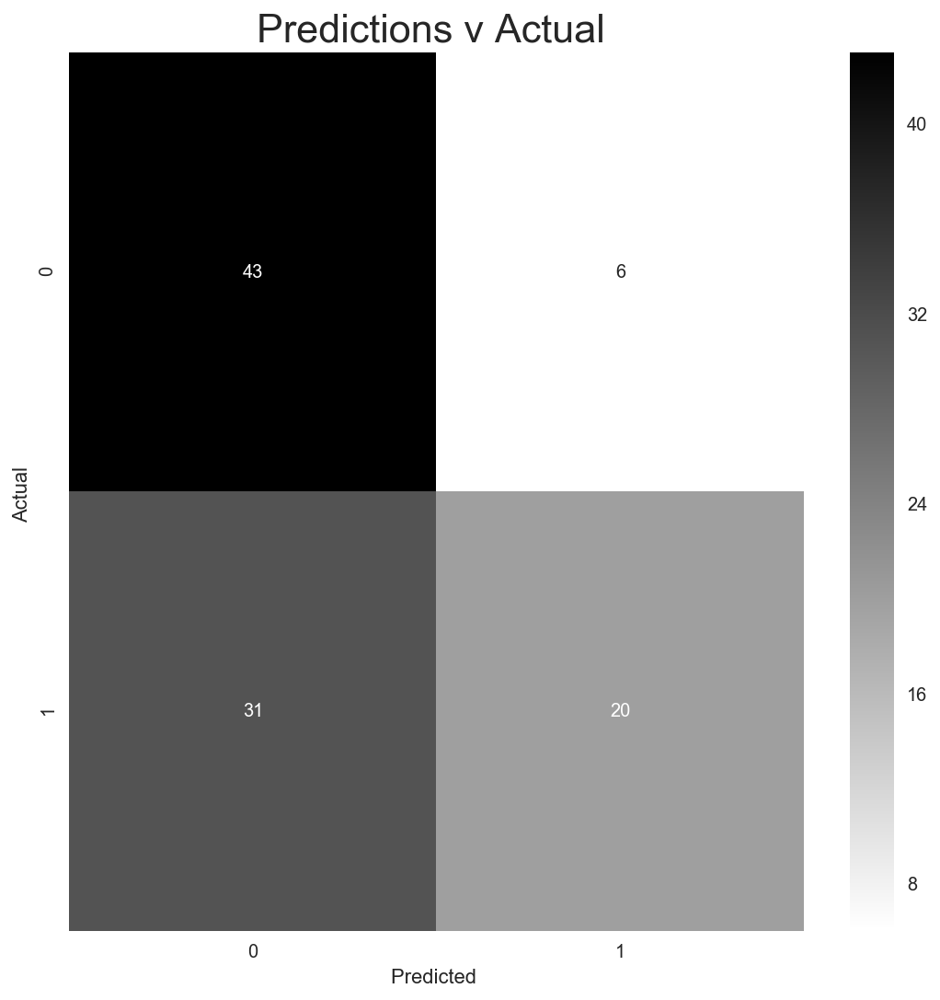

In [14]:
plt.figure(figsize=(8,8))
sns.heatmap(cm_iranian5050, annot=True, fmt="d", cmap="gist_gray_r")
sns.set(font_scale=1.8)
plt.title("Predictions v Actual ")
plt.ylabel("Actual ")
plt.xlabel("Predicted ")
plt.tight_layout()

In [15]:
print("Accuracy Score:", accuracy_score(y_iranian, pred_iranian5050))
print("Precision Score :", precision_score(y_iranian, pred_iranian5050))
print("Recall Score:", recall_score(y_iranian, pred_iranian5050))
print("f1 Score:", f1_score(y_iranian, pred_iranian5050))

Accuracy Score: 0.63
Precision Score : 0.7692307692307693
Recall Score: 0.39215686274509803
f1 Score: 0.5194805194805195


### ANALYSIS:
The LR model performed poorly as expected against this Iranian test set, correctly classifying just 63 out of 100 tweets (compared to 90 under similar conditions for the Russia/IRA unseen test set).

It only managed to pick out 20 of the fake Iranian tweets correctly, and wrongly classified 31 others as real tweets when they are in fact the work of Iranian state operators. The model's dismal recall score makes it a straight disqualifier. But for argument's sake, let's see how it does with a different fake-real tweets split.

## 2.2 A 70-30 TEST
Like in the Russian test set, I'll shift the sampling weight such that the Iranian unseen test set has about 70% real tweets and 30% fake tweets.

In [16]:
iranian_unseen['70real_30fake'] = np.where(iranian_unseen['bot_or_not'] == 0, 0.7, 0.3)

In [17]:
iranian_test7030 = iranian_unseen.sample(n=100, random_state=42, weights='70real_30fake')

In [18]:
y_iranian7030 = iranian_test7030['bot_or_not']
X_iranian7030 = iranian_test7030['clean_tweet_text']

In [19]:
# The split is not precise, but good enough
y_iranian7030.value_counts()

0    66
1    34
Name: bot_or_not, dtype: int64

In [20]:
pred_unseen7030 = LR.predict(X_iranian7030)
pred_unseen7030

array([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,
       1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0])

In [21]:
cm_unseen7030 = confusion_matrix(y_iranian7030, pred_unseen7030)
cm_unseen7030

array([[61,  5],
       [26,  8]])

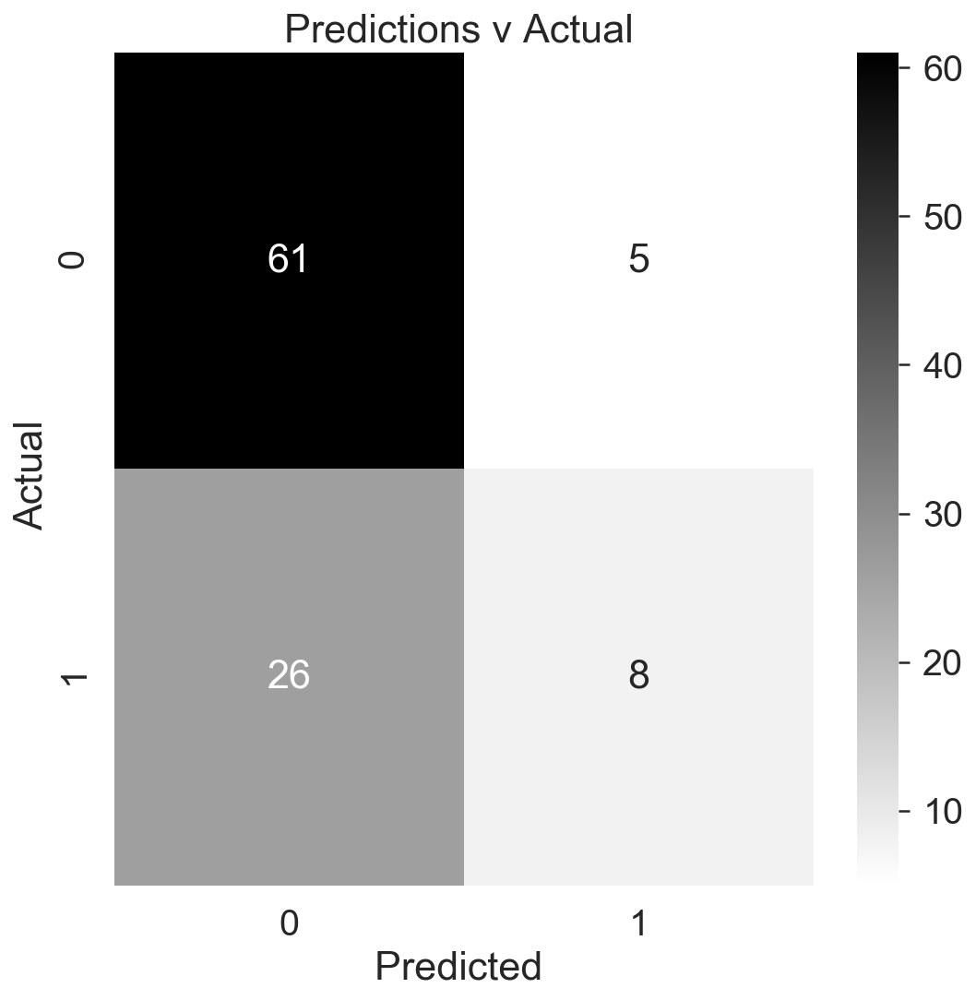

In [22]:
plt.figure(figsize=(8,8))
sns.heatmap(cm_unseen7030, annot=True, fmt="d", cmap="gist_gray_r")
sns.set(font_scale=1.8)
plt.title("Predictions v Actual ")
plt.ylabel("Actual ")
plt.xlabel("Predicted ")
plt.tight_layout()

In [23]:
print("Accuracy Score:", accuracy_score(y_iranian7030, pred_unseen7030))
print("Precision Score :", precision_score(y_iranian7030, pred_unseen7030))
print("Recall Score:", recall_score(y_iranian7030, pred_unseen7030))
print("f1 Score:", f1_score(y_iranian7030, pred_unseen7030))

Accuracy Score: 0.69
Precision Score : 0.6153846153846154
Recall Score: 0.23529411764705882
f1 Score: 0.3404255319148936


### ANALYSIS:
The model's recall score worsens, as it managed to correctly classify a smaller proportion of fake tweets (our true positives in this case) compared to the 50-50 split. Its accuracy improved, unsurprisingly, as there were more real tweets (majority class) and the model had been trained on tweets by the same group of real American users.

## 2.3 A CLOSER LOOK AT THE WRONGLY CLASSIFIED IRANIAN STATE TWEETS
Let's take a closer at the misclassified tweets to see if they have anything in common. This time round, the model has thrown up more false negatives than false positives, ie, tweets which it classified as real were in fact fake. Let's see what tweets that triggered the wrong predictions.

In [24]:
# Starting with false negatives in the 50-50 set
iranian_test['pred'] = pred_iranian5050

In [25]:
iran_wrong_pred5050 = iranian_test[(iranian_test['pred'] == 0) & (iranian_test['bot_or_not'] == 1)]

In [26]:
# Here I'm listing the tweets which the model predicted as real, but in fact state-backed tweets by Iran 
iran_wrong_pred5050['tweet_text'].values

array(["Boris Johnson would 'rather stay in' the EU than accept a soft Brexit #brexit #BorisJohnson #BlueMonday #Carillion #CreativeCase https://t.co/sdmKMJE77X",
       '#Saudi Arabia is funding Islamist terrorism in #Britain https://t.co/5CS1CAp6jM',
       'cfb431d28838bc87b3473081cc5899cfede8252c2015644ffeccd7b27b1149fb - European Car Sales Fell 5.6% in June http://t.co/36olEYkxyx',
       'cfb431d28838bc87b3473081cc5899cfede8252c2015644ffeccd7b27b1149fb - Scientific Proof That Drinking #Soda Makes Brains Hyperactive: http://t.co/MHDBBkyAva',
       'An overview of Mina camps. Hajis are in Mina tonight, may Allah accept from you and grant you incredible life-changing blessings through it.#Hajj2018  #FromMasjidAlHaram https://t.co/Mj5J7BTpK5',
       'Protesters Rallied In Paris Against Netanyahu https://t.co/IsUkr8VQtm #Palestine #paris #Israel #Netanyahu #TheWalkingDead #HereWeGo #Ravens #RejectedCountryBandNames #RHOA  #OMASSE #ASCOL #HommageAJohnny #MUNMCI #ElectionLR2017 https:

### At first glance, it appears that several words which were not common in the Russian test set, such as Saudi Arabia and Netanyahu, have appeared and could have tripped up the model. Let's confirm our intuition with a simple token frequency chart.

In [27]:
vect = CountVectorizer(stop_words='english', ngram_range=(1,2))
docs = vect.fit_transform(iranian_test['clean_tweet_text'])
features = vect.get_feature_names()

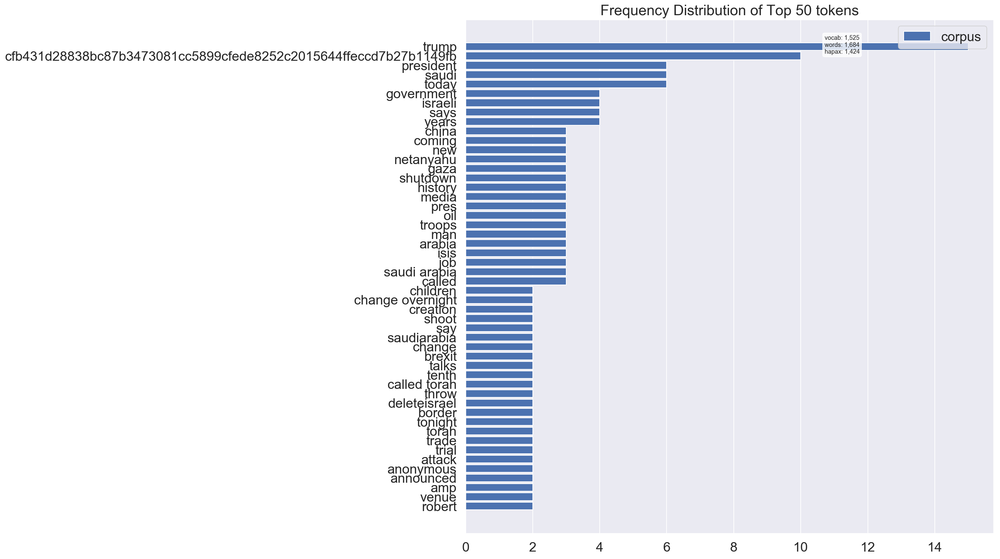

In [28]:
plt.figure(figsize=(14,14))
visualiser = FreqDistVisualizer(features=features)
visualiser.fit(docs)
visualiser.poof()
plt.show()

### Chart 15 above can help explain why the model's classification performance plunged for the Iranian set. We see words like "israeli" and "netanyahu", which were not among the top 50 terms in the Russian test set. The word "gaza", for instance, appeared just 55 times in the 50,000 tweets originally used to train the model.

### Next, let's take a closer clook at some specific tweets and the model's predicted probabbilities for that particular tweet.

## 2.4 EXAMINING THE PREDICT PROBA OF SOME WRONGLY CLASSIFIED IRANIAN STATE TWEETS

In [29]:
#The model predicted this as a real tweet, when it was in fact fake
iranian_test.iloc[6]

account_creation_date                                              2017-04-15
bot_or_not                                                                  1
clean_tweet_text            saudi arabia is funding islamist terrorism in ...
follower_count                                                           9600
following_count                                                          9290
tweet_text                  #Saudi Arabia is funding Islamist terrorism in...
tweet_time                                                   2017-07-13 01:35
tweetid                                                    885311789331828736
user_profile_description    As an independent news media organization we a...
user_reported_location                                          United States
user_screen_name                                                 berniecratss
pred                                                                        0
Name: 926, dtype: object

In [30]:
# Let's check the predicted probabilities for this tweet
# The model was, unfortunately, very confident that this was a real tweet when it was in fact fake
pred_proba_iranian5050[6]

array([0.98169043, 0.01830957])

In [31]:
#The model also predicted this as a real tweet, when it was in fact fake
iranian_test.iloc[15]

account_creation_date                                              2017-05-28
bot_or_not                                                                  1
clean_tweet_text            an overview of mina camps hajis are in mina to...
follower_count                                                           4581
following_count                                                          5257
tweet_text                  An overview of Mina camps. Hajis are in Mina t...
tweet_time                                                   2018-08-20 16:30
tweetid                                                   1031579253207388161
user_profile_description    As an independent news media organization we a...
user_reported_location                                          United States
user_screen_name            1803a95a0ab8963650589f13672df24b04f51db32cf950...
pred                                                                        0
Name: 999, dtype: object

In [32]:
# Let's check the predicted probabilities for this tweet
# Somewhat less certain this time
pred_proba_iranian5050[15]

array([0.67269759, 0.32730241])

In [33]:
#The model also predicted this as a real tweet, when it was in fact fake
iranian_test.iloc[70]

account_creation_date                                              2017-08-30
bot_or_not                                                                  1
clean_tweet_text            netanyahu pays rare visit to occupied golan he...
follower_count                                                           2924
following_count                                                          1305
tweet_text                  Netanyahu pays rare visit to Occupied Golan He...
tweet_time                                                   2018-02-07 07:30
tweetid                                                    961140092525006849
user_profile_description    Chief Editor of IUVM Online #News Agency      ...
user_reported_location                                England, United Kingdom
user_screen_name            4a810dd520182c19d799b3028f640fe05fd23d78c964fb...
pred                                                                        0
Name: 367, dtype: object

In [34]:
# Let's check the predicted probabilities for this tweet
# Again, the model was confident but turned out to be wrong
pred_proba_iranian5050[70]

array([0.99182032, 0.00817968])

### ANALYSIS:
Unfortunately and somewhat surprisingly, the model was pretty sure about its wrong classifications. In 2 out of 3 tweets above, we see that it predicted with near certainty that the tweet was real, when it was in fact fake. 

The results show how such classification models can be defeated in cases where it doesn't understand the geopolitical context, or if tweets are fashioned very closely to what a normal news tweet might look.

This also makes it difficult to finetune the model, such as by adjusting the threshold of its predictions.

## 2.5 USING SHAP TO EXAMINE SOME WRONGLY CLASSIFIED IRANIAN STATE TWEETS
While the predicted probabilities give us a sense of how the model made its decisions for individual tweets, there isn't sufficient granularity with regards to what features pushed the individual outcomes in a certain way. Here's where SHAP can shed light on what caused a prediction to go in either direction.

In [35]:
# First, we need to extract the finalised model out from the pipeline for SHAP to work
logreg = LR.named_steps['clf']
logreg

LogisticRegression(C=55.41020330009492, class_weight=None, dual=False,
          fit_intercept=True, intercept_scaling=1, max_iter=100,
          multi_class='warn', n_jobs=None, penalty='l2', random_state=None,
          solver='liblinear', tol=0.0001, verbose=0, warm_start=False)

In [36]:
# Creating a new pipeline using the count and tfidf vectorizers extracted from my pickled model
# this is needed for ths SHAP workflow
pipeline = make_pipeline(LR.named_steps['vect'], LR.named_steps['tfidf'])

In [37]:
# Recall the Iranian unseen test set
y_iranian = iranian_test['bot_or_not']
X_iranian = iranian_test['clean_tweet_text']

In [38]:
iranian_dtm = pipeline.transform(X_iranian)

In [39]:
explainer = shap.LinearExplainer(logreg, iranian_dtm, feature_dependence="independent")
shap_values = explainer.shap_values(iranian_dtm)
iranian_array = iranian_dtm.toarray() # we need to pass a dense version for the plotting functions

In [40]:
ind = 6
shap.force_plot(
    explainer.expected_value,
    shap_values[ind, :],
    iranian_array[ind, :],
    feature_names=LR.named_steps['vect'].get_feature_names(),
)


In [41]:
# Model got this wrong, predicting it as a real tweet when it is fake.
print("State-backed" if y_iranian.iloc[ind] else "Real", "Tweet:")
print(X_iranian.iloc[ind])

State-backed Tweet:
saudi arabia is funding islamist terrorism in britain


### ANALYSIS:
In this tweet, two terrorism related words pushed the model in different directions, though the combination of factual words like "britain" and "saudi" eventually pushed the model towards thinking this is a real tweet - when in fact it is a troll tweet. 

Short, factual declarative tweets like this seem to be successful in tricking the model.

In [42]:
ind = 44
shap.force_plot(
    explainer.expected_value,
    shap_values[ind, :],
    iranian_array[ind, :],
    feature_names=LR.named_steps['vect'].get_feature_names(),
)

In [43]:
# Model also got this wrong, predicting it as a real tweet when it is fake. 
print("State-backed" if y_iranian.iloc[ind] else "Real", "Tweet:")
print(X_iranian.iloc[ind])

State-backed Tweet:
spain italy warn against investing in israeli settlements


### ANALYSIS:
Again, we see a similar pattern: Factual words and country names pushed the model towards classifying this as a real tweet. There were no obvious signs, such as the use of certain hashtags, that could signal this was a troll tweet. This is where local knowledge of the person behind the machine learning model becomes useful in checking the work of the algorithm.


Now let's see if the Venezuelian test set turns out the same way.

## 3. VENEZUELA UNSEEN TEST SET
Let's call up the Venezuelian unseen test set that we built in notebook 1.4. This is part of the corpus of Venezuelian state-backed tweets released by Twitter in October 2018, of about 1 million tweets from 764 accounts.

In [44]:
# Calling up the Venezuelian unseen test dataset created in notebook 1.4 Section 3
vz_unseen = pd.read_csv('../data/vz_unseen.csv')

In [45]:
# I won't need to test the entire unseen set against the model, so let's drop the empty rows
vz_unseen = vz_unseen.dropna()

In [46]:
# For some reason this column's data-type became an object. Switching it back to integer
# Otherwise it would throw an error later on
vz_unseen['bot_or_not'] = vz_unseen['bot_or_not'].astype(int)

## 3.1 A 50-50 TEST
As per the previous tests, we'll start with an even mix of fake Venezuelian and real US tweets among the 100 tweets that we will test the model on. 

In [47]:
# Grab a sample of 100 tweets from the unseen set
vz_test = vz_unseen.sample(n=100, random_state=42)

In [48]:
y_vz = vz_test['bot_or_not']
X_vz = vz_test['clean_tweet_text']

In [49]:
y_vz.value_counts()

0    53
1    47
Name: bot_or_not, dtype: int64

In [50]:
pred_vz5050 = LR.predict(X_vz)
pred_vz5050

array([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1,
       1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0])

In [51]:
pred_proba_vz5050 = LR.predict_proba(X_vz)

In [52]:
cm_vz5050 = confusion_matrix(y_vz, pred_vz5050)
cm_vz5050

array([[44,  9],
       [32, 15]])

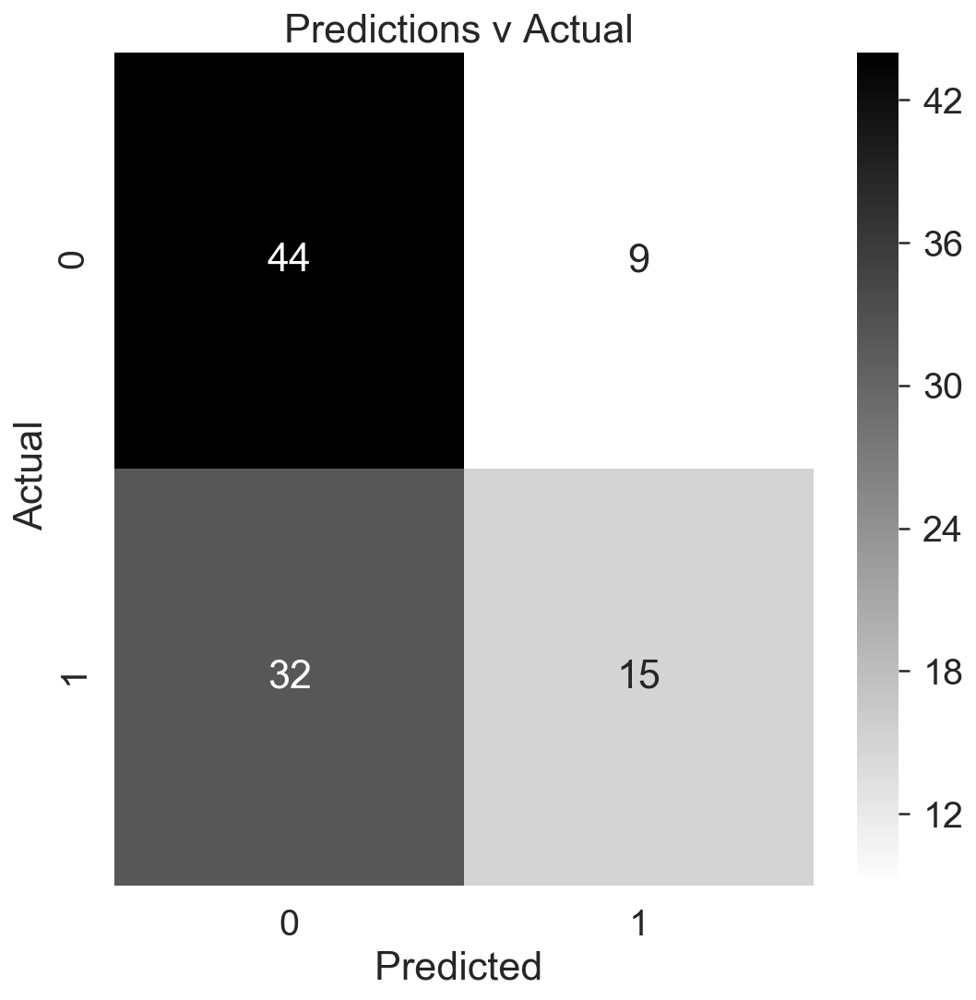

In [53]:
plt.figure(figsize=(8,8))
sns.heatmap(cm_vz5050, annot=True, fmt="d", cmap="gist_gray_r")
sns.set(font_scale=1.8)
plt.title("Predictions v Actual ")
plt.ylabel("Actual ")
plt.xlabel("Predicted ")
plt.tight_layout()

In [54]:
print("Accuracy Score:", accuracy_score(y_vz, pred_vz5050))
print("Precision Score :", precision_score(y_vz, pred_vz5050))
print("Recall Score:", recall_score(y_vz, pred_vz5050))
print("f1 Score:", f1_score(y_vz, pred_vz5050))

Accuracy Score: 0.59
Precision Score : 0.625
Recall Score: 0.3191489361702128
f1 Score: 0.4225352112676056


### ANALYSIS:
The LR model performed even worse this time, compared to the Iranian and Russian test results. It correctly classified just 59 tweets out of 100, missing 32 fake tweets which it classified as real. 

This is clearly unacceptable from a business-use case, but in the context of this project, the results perfectly illustrate how complex it is to build machine learning models to detect such state-backed influence operations, which are highly adaptable and specific (as opposed to generic, which makes them easier to spot).

Let's do one more test with the Venezuelian test set.

## 3.2 A 70-30 TEST
This time, I'll shift the sampling weight such that the unseen test set has about 70% real tweets and 30% fake tweets.

In [55]:
vz_unseen['70real_30fake'] = np.where(vz_unseen['bot_or_not'] == 0, 0.7, 0.3)

In [56]:
vz_test7030 = vz_unseen.sample(n=100, random_state=42, weights='70real_30fake')

In [57]:
y_vz7030 = vz_test7030['bot_or_not']
X_vz7030 = vz_test7030['clean_tweet_text']

In [58]:
# The split is not precise, but good enough
y_vz7030.value_counts()

0    66
1    34
Name: bot_or_not, dtype: int64

In [59]:
pred_vz7030 = LR.predict(X_vz7030)
pred_vz7030

array([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0])

In [60]:
cm_vz7030 = confusion_matrix(y_vz7030, pred_vz7030)
cm_vz7030

array([[65,  1],
       [21, 13]])

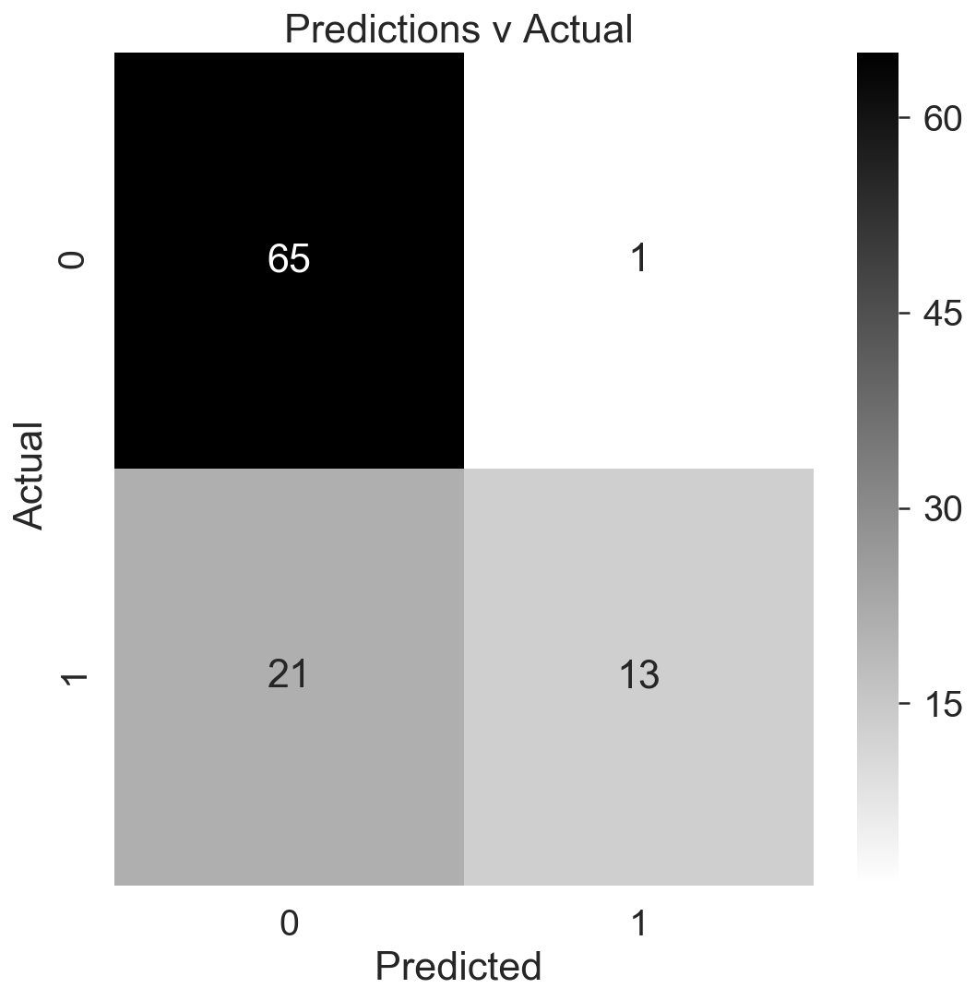

In [61]:
plt.figure(figsize=(8,8))
sns.heatmap(cm_vz7030, annot=True, fmt="d", cmap="gist_gray_r")
sns.set(font_scale=1.8)
plt.title("Predictions v Actual ")
plt.ylabel("Actual ")
plt.xlabel("Predicted ")
plt.tight_layout()

In [62]:
print("Accuracy Score:", accuracy_score(y_vz7030, pred_vz7030))
print("Precision Score :", precision_score(y_vz7030, pred_vz7030))
print("Recall Score:", recall_score(y_vz7030, pred_vz7030))
print("f1 Score:", f1_score(y_vz7030, pred_vz7030))

Accuracy Score: 0.78
Precision Score : 0.9285714285714286
Recall Score: 0.38235294117647056
f1 Score: 0.5416666666666667


### ANALYSIS:
Surprisingly, the model's performance picked up in this split. It correctly classified 78 of the tweets, but could only pick out 13 of the 34 fake weeks. It wrongly classified most of the fake tweets in fact, classifying 21 of them as real when they are in fact the work of state operators.

Overall, its poor recall scores in this test suggested that the model could not generalise well at all.

## 3.3 CLOSER LOOK AT THE WRONGLY CLASSIFIED VENEZUELIAN STATE TWEETS
Let's take a closer at the misclassified Venezuelian state tweets to see if they have anything in common. Like in the Iranian set, the LR model has thrown up more false negatives than false positives, ie, tweets which it classified as real were in fact fake. Let's see what tweets that triggered the wrong predictions.

In [63]:
# Starting with false negatives in the 50-50 set
vz_test['pred'] = pred_vz5050

In [64]:
vz_wrong_pred5050 = vz_test[(vz_test['pred'] == 0) & (vz_test['bot_or_not'] == 1)]

In [65]:
# These are the tweets by Venezuelian state operators which the LR model incorrectly classified as real
vz_wrong_pred5050['tweet_text'].values

array(['BREAKING : New Trump Admin Policy Will Have Illegal Alien Advocates in Tears! https://t.co/ifrcwQl5Rs https://t.co/m3iXeYVujQ',
       'CLOWN SHOW TO END? Pro-Trump Challenger Announces Bid to Unseat Kaine https://t.co/e15Om1H2LE https://t.co/nc6eJa9eFu',
       '#ste WTF?! California is Choosing ILLEGALS Over the American Middle Class https://t.co/w1j1Hov4hR https://t.co/O35YD7MnOQ',
       'Traitor Mccain Uses CHEAP TACTIC to Force Delay of Trumpcare Vote! https://t.co/r8gWYI1bec https://t.co/GMlE3pETdY',
       'VIDEO : Kristin Tate SLAMS Jane Sanders for Her Pathetic “SEXISM CARD” https://t.co/DENgPVQEHU https://t.co/ozPIovN1ae',
       '#ste BREAKING : Obama is Pushing THIS Buddy of His to Run in 2020 https://t.co/F5tYMTJBcG https://t.co/N0t5d3D0RZ',
       'Dem Lawmaker Who Threatened Trump’s Life Gives Phony “Non-Apology” Apology https://t.co/Y5qWaRAbRi https://t.co/M50xyiMUUg',
       'Look Who Kamala Harris Will Have to Fight Out for the Dem Nomination https://t.co/eGg

### Interestingly these Venezuelian state tweets look very similar to those by the Russians. Some indeed come across as "obvious" fake tweets. Let's plot a frequency token chart to see there are any unusual patterns.

In [66]:
vect = CountVectorizer(stop_words='english', ngram_range=(1,2))
docs = vect.fit_transform(vz_test['clean_tweet_text'])
features = vect.get_feature_names()

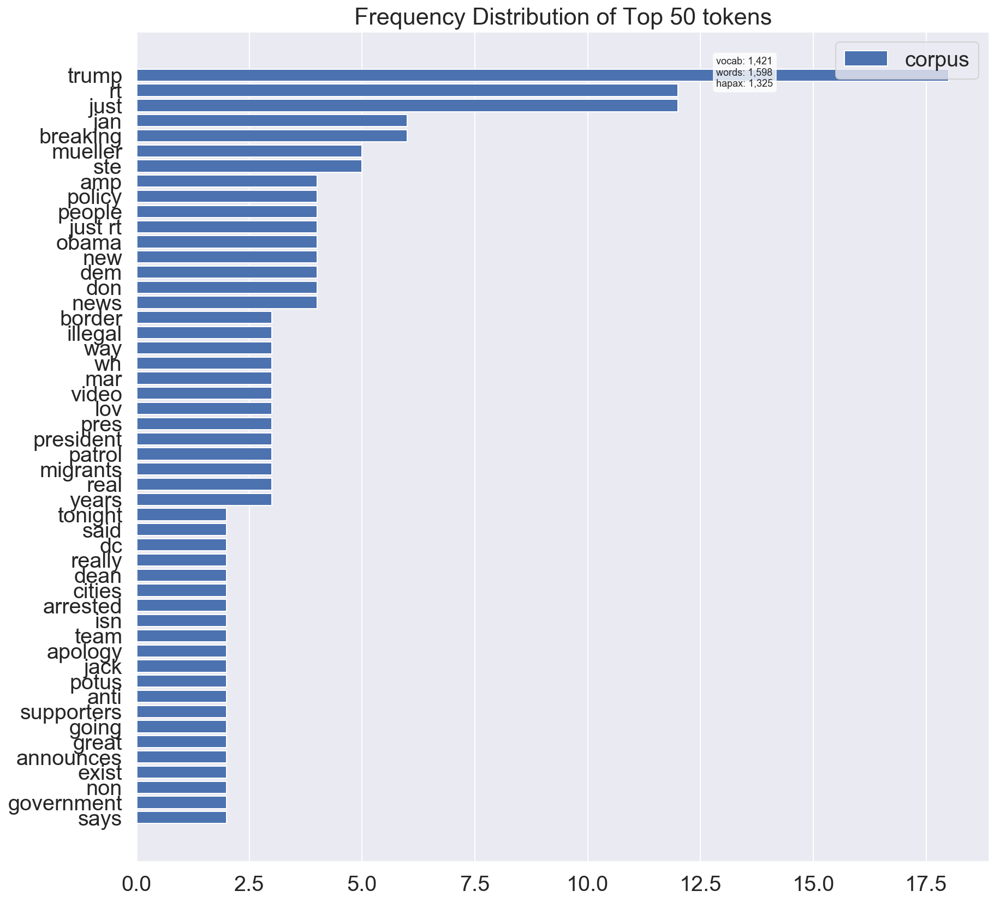

In [67]:
plt.figure(figsize=(14,14))
visualiser = FreqDistVisualizer(features=features)
visualiser.fit(docs)
visualiser.poof()
plt.show()

### CHART 16 (ABOVE) shows the top 50 terms in the Venezuelian test set. The top terms are an interesting combination of familiar terms like "trump" and "obama" which we saw in the Russian training and test sets. But this time, the Venezuelian set also contains words like "migrants" and "electric" which were not so common in the Russian sets, as a quick check below shows.

In [68]:
combo5050['clean_tweet_text'].str.contains('migrants').value_counts()

False    49883
True       117
Name: clean_tweet_text, dtype: int64

In [69]:
combo5050['clean_tweet_text'].str.contains('electric').value_counts()

False    49945
True        55
Name: clean_tweet_text, dtype: int64

## 3.4 EXAMINING THE PREDICT PROBA OF SOME WRONGLY CLASSIFIED IRANIAN STATE TWEETS

In [70]:
#The model predicted this as a real tweet, when it was in fact fake
vz_test.iloc[5]

account_creation_date                                              2017-07-04
bot_or_not                                                                  1
clean_tweet_text            clown show to end pro trump challenger announc...
follower_count                                                            782
following_count                                                          3640
tweet_text                  CLOWN SHOW TO END? Pro-Trump Challenger Announ...
tweet_time                                                   2017-07-14 18:03
tweetid                                                           8.85923e+17
user_profile_description    Journalist dedicated to exclusive information,...
user_reported_location                                          United States
user_screen_name                  GDIaCsORWRKfkUJsOuqsUiNcqhbHLJMWu93UFnMa6Y=
pred                                                                        0
Name: 1001, dtype: object

In [71]:
pred_proba_vz5050[5]

array([0.90938925, 0.09061075])

In [72]:
#The model also predicted this as a real tweet, when it was in fact fake
vz_test.iloc[16]

account_creation_date                                              2017-07-26
bot_or_not                                                                  1
clean_tweet_text            ste breaking obama is pushing this buddy of hi...
follower_count                                                            779
following_count                                                          2821
tweet_text                  #ste BREAKING : Obama is Pushing THIS Buddy of...
tweet_time                                                   2017-08-01 18:25
tweetid                                                           8.92451e+17
user_profile_description    Journalist highlighted in taking the best info...
user_reported_location                                          United States
user_screen_name                 wusEXnOUoeG8bfSFMYqUjMyhNZVKKn6hKwrWPW3v1ik=
pred                                                                        0
Name: 124, dtype: object

In [73]:
pred_proba_vz5050[16]

array([0.63643341, 0.36356659])

In [74]:
#The model also predicted this as a real tweet, when it was in fact fake
vz_test.iloc[47]

account_creation_date                                              2017-07-13
bot_or_not                                                                  1
clean_tweet_text            here it is folks we just learned who trump col...
follower_count                                                            305
following_count                                                           957
tweet_text                  Here It Is Folks! We Just Learned Who Trump Co...
tweet_time                                                   2017-07-13 22:24
tweetid                                                           8.85626e+17
user_profile_description    Journalist, passionate about taking informatio...
user_reported_location                                          United States
user_screen_name                  u4JYTwWbY74J9f9DZSz3Bzw92HwEY0vEo6bOK09P68=
pred                                                                        0
Name: 128, dtype: object

In [75]:
pred_proba_vz5050[47]

array([0.97190276, 0.02809724])

### ANALYSIS:
Again, the LR model predicts with near certaintly that two of these 3 fake tweets are indeed real.

The LogReg model just doesn't generalise well, as expected. But perhaps it is unrealistic to expect the model to do so, given the inherent nature of the problem.

I'll write up a fuller summary report at the end of this project.

In the next notebook, I'll explore the question of whether a similarly designed model, but trained on Iranian tweets, can do as well in terms of picking out Iranian state tweets.

## 3.5 SHAP ANALYSIS OF INCORRECT VENEZUELAN PREDICTIONS

In [76]:
# Recall the Venezuelian unseen test set
y_vz = vz_test['bot_or_not']
X_vz = vz_test['clean_tweet_text']

In [77]:
vz_dtm = pipeline.transform(X_vz)

In [78]:
explainer = shap.LinearExplainer(logreg, vz_dtm, feature_dependence="independent")
shap_values = explainer.shap_values(vz_dtm)
vz_array = vz_dtm.toarray() # we need to pass a dense version for the plotting functions

In [79]:
ind = 47
shap.force_plot(
    explainer.expected_value,
    shap_values[ind, :],
    vz_array[ind, :],
    feature_names=LR.named_steps['vect'].get_feature_names(),
)

In [80]:
# Wrong Prediction. It's a troll tweet but model classified as real
print("State-backed" if y_vz.iloc[ind] else "Real", "Tweet:")
print(X_vz.iloc[ind])

State-backed Tweet:
here it is folks we just learned who trump colluded with to win the election


### ANALYSIS:
In the tweet above, we see that the factual words "election" and "learned" pushed the model towards classifying this as a real tweet. But it was in fact a troll tweet. Again, there is nothing on the surface that might immediately suggest this to be a troll tweet. 

In [81]:
ind = 72
shap.force_plot(
    explainer.expected_value,
    shap_values[ind, :],
    vz_array[ind, :],
    feature_names=LR.named_steps['vect'].get_feature_names(),
)

In [82]:
# Wrong Prediction by model. It's a troll tweet but the model classified it as a real tweet
print("State-backed" if y_vz.iloc[ind] else "Real", "Tweet:")
print(X_vz.iloc[ind])

State-backed Tweet:
breaking the dc swamp just made it obvious who they favor in 2020


### ANALYSIS:
This tweet might seem obviously fake to a regular follower of US politics, but for a machine learning model, it could be factual - as we see how it wrongly classifies it as a real tweet here. The word "swamp" pushed the model towards classifying it as a troll tweet, but that was overruled by the words "favor" and "2020".

Ultimately, human assessment is still needed to tweak and improve the performance of the machine learning model, as we've seen in the examples to date where predictions go wrong.

In notebook3.2, I'll build an alternative model trained on Iranian troll tweets to see if it can better detect tweets by that country's state-operator. 